In [1]:
import os, sys
import numpy as np
import scipy.io as sio
import pandas as pd
import matplotlib.pyplot as plt

# my libarary
from tuning import spike
from tuning import Tuning

def loadmat(filename):
    return sio.loadmat(filename, struct_as_record=False, squeeze_me=True)

In [2]:
ephys_file = './kilosort/kilosort_data.mat'
meta_file = './kilosort/meta.csv'
nidq_file = ['./event/bmi_20201012_g0_t0_data.mat',
            './event/bmi_20201012_g1_t0_data.mat',
            './event/bmi_20201012_g2_t0_data.mat',
            './event/bmi_20201012_g3_t0_data.mat']
ptb_file = ['./event/ptb_20201012_151925.mat',
            './event/ptb_20201012_155256.mat',
           './event/ptb_20201012_160528.mat',
           './event/ptb_20201012_161421.mat']

In [3]:
ephys = loadmat(ephys_file)
meta = pd.read_csv(meta_file)

n_unit = ephys['Spike'].nUnit
n_session = meta.shape[0]
channel = ephys['Spike'].maxChannel

time_spike = np.zeros((n_session, n_unit), dtype=np.object)
for i in range(n_session):
    for j in range(n_unit):
        time_temp = ephys['Spike'].time[j]
        if i < n_session - 1:
            in_time = (time_temp >= meta.start[i]/25000) & (time_temp < meta.start[i+1]/25000)
        else:
            in_time = (time_temp >= meta.start[i]/25000)
                
        time_spike[i, j] = time_temp[in_time] - meta.start[i] / 25000

0
slope: 0.9999983662740491, intercept: 3.9611269343708955e-05, r-squared: 0.9999999999999702
n=0 outliers


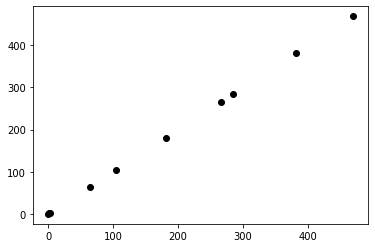

1
slope: 0.9999984996728505, intercept: 3.453717043555571e-05, r-squared: 0.9999999999999802
n=0 outliers


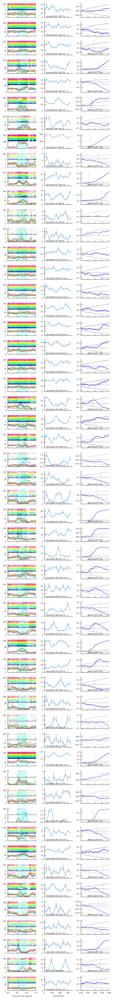

2
slope: 0.9999982987512285, intercept: 2.7241391876486887e-05, r-squared: 0.9999999999999811
n=0 outliers


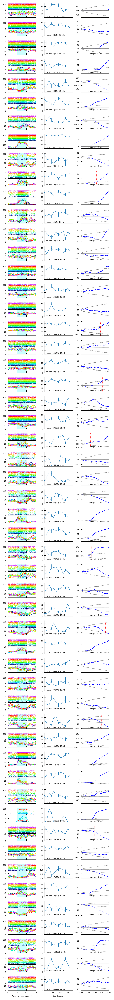

3
slope: 0.9999981155338338, intercept: 1.794504424879051e-05, r-squared: 0.9999999999999796
n=0 outliers


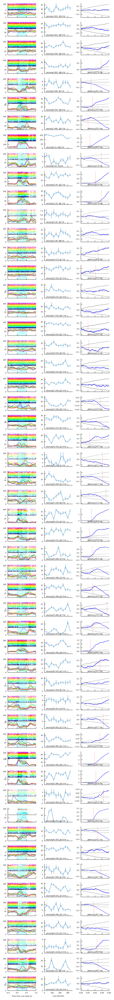

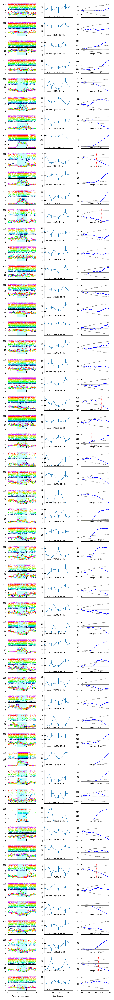

In [4]:
# checking visual response

for session in range(n_session):
    print(session)
    t = Tuning()
    t.load_event(nidq_file[session])
    t.load_ptb(ptb_file[session])
    t.load_kilosort(time_spike[session, :], channel)
    plt.close('all')
    f = t.plot()
    f.savefig('bmi_{}.png'.format(session))

1
slope: 0.9999984996728505, intercept: 3.453717043555571e-05, r-squared: 0.9999999999999802
n=0 outliers


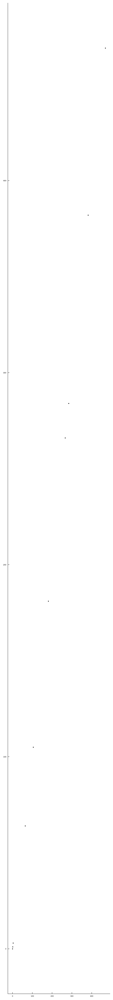

2
slope: 0.9999982987512285, intercept: 2.7241391876486887e-05, r-squared: 0.9999999999999811
n=0 outliers


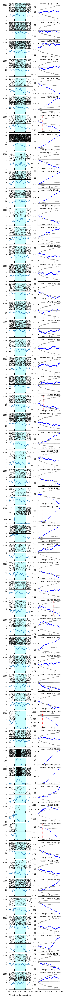

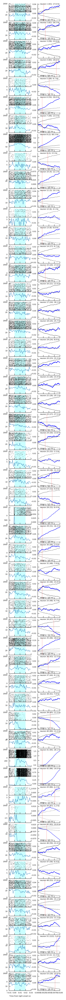

In [5]:
# checking laser response
for session in [1, 2]:
    print(session)
    t = Tuning()
    t.load_event(nidq_file[session])
    t.load_ptb(ptb_file[session])
    t.load_kilosort(time_spike[session, :], channel)
    plt.close('all')
    f = t.plot_laser()
    f.savefig('bmi_laser_{}.png'.format(session))

r-squared: 0.999999999999992


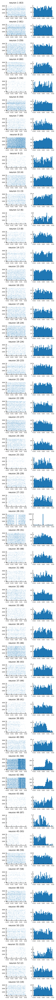

In [61]:
# checking laser response (narrower time window)
t = Tuning()

epoch = 2
t.load_event(nidq_file[epoch])

#laser_time = t.laser_time_fpga
laser_time = time_spike[epoch, 27].copy()
laser_type = np.ones_like(laser_time)
plt.figure(figsize=(3, 1*n_unit))
for unit in range(n_unit):
    raster, psth = spike.plot(time_spike[epoch, unit], laser_time, laser_type, 
                              window=[-0.02, 0.02], binsize=0.001, resolution=5)
    
    plt.subplot(n_unit, 2, unit*2+1)
    plt.plot(raster['x'][0], raster['y'][0], '.')
    plt.title('neuron {} ({})'.format(unit+1, channel[unit]))
    
    plt.subplot(n_unit, 2, unit*2+2)
    plt.bar(psth['t'], psth['bar'][0], width=0.001)
plt.tight_layout()

r-squared: 0.9999999999999885


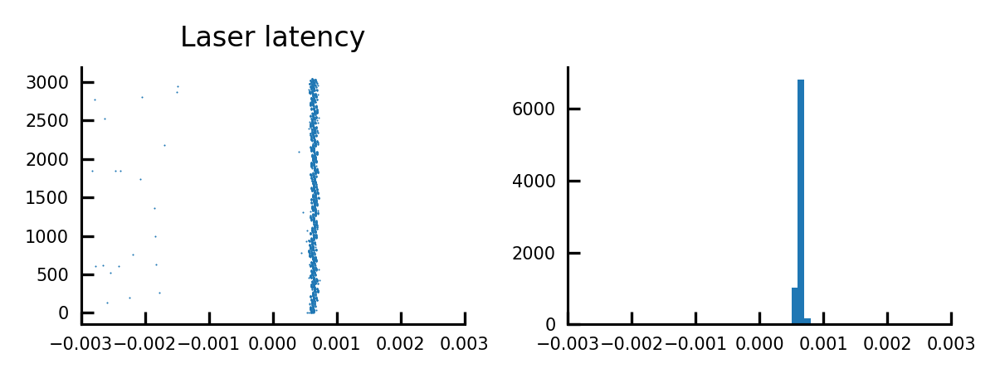

In [60]:
# checking laser response
t = Tuning()

epoch = 1
t.load_event(nidq_file[epoch])

laser_time = time_spike[epoch, 27].copy()
laser_type = np.ones_like(laser_time)

raster, psth = spike.plot(t.laser_time_fpga, laser_time, laser_type, 
                          window=[-0.003, 0.003], binsize=0.0001, resolution=5)

plt.figure(figsize=(4, 1.5))
ax = plt.subplot(1, 2, 1)
plt.plot(raster['x'][0], raster['y'][0], '.')
plt.title('Laser latency')
ax.set_xlim([-0.003, 0.003])
   
ax = plt.subplot(1, 2, 2)
plt.bar(psth['t'], psth['bar'][0], width=0.0001)
ax.set_xlim([-0.003, 0.003])
plt.tight_layout()

# Check latency of visual stimuli

In [90]:
epoch = 2
t = Tuning()
t.load_event(nidq_file[epoch])
t.load_ptb(ptb_file[epoch])
t.load_kilosort(time_spike[epoch, :], channel)

r-squared: 0.999999999999992


- Variables  
'cue_time_fpga',
'cue_time_nidq',
'cue_type',
'event_file',
'event_filetime',
'event_path',
'laser_time_fpga',
'laser_time_nidq',
'ptb_file',
'spike_file',
'spike_fr',
'spike_group',
'spike_time',
'sync_event',
'sync_time_fpga',
'sync_time_nidq'

(-0.05, 0.1)

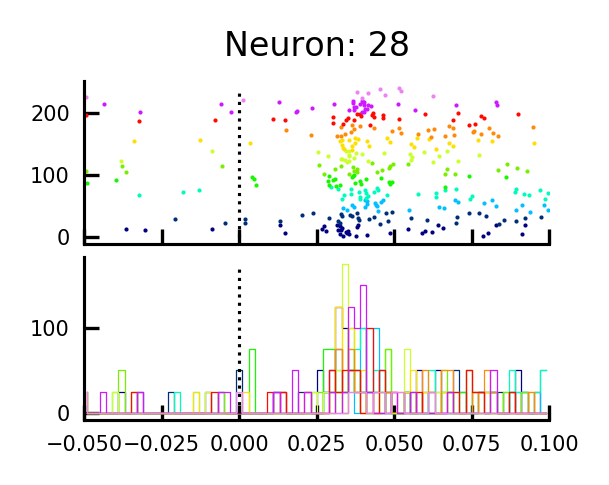

In [93]:
window_cue = [-0.05, 0.10]
cue_time = t.cue_time_fpga
cue_type = t.cue_type
n_type = len(np.unique(cue_type))

linecolor = plt.cm.gist_ncar(np.linspace(0, 0.9, n_type))[:, 0:3]

i_unit = 27
#spike_time = t.spike_time[i_unit]
spike_time = t.laser_time_fpga
raster, psth = spike.plot(spike_time, cue_time, cue_type, window=window_cue, binsize=0.002)

fig, ax = plt.subplots(2, 1, figsize=(2, 1.5))
for i_type in range(n_type):
    ax[0].plot(raster['x'][i_type], raster['y'][i_type], '.', color=linecolor[i_type, :], markersize=2)
    ax[1].step(psth['t'], psth['bar'][i_type, :], color=linecolor[i_type, :], linewidth=0.3)

ax[0].plot([0, 0], [0, len(cue_time)], 'k:')
ax[1].plot([0, 0], [0, np.max(psth['bar'])], 'k:')
ax[0].set_title('Neuron: {}'.format(i_unit + 1))
ax[0].set_xlim(window_cue)
ax[0].set_xticklabels([])
ax[1].set_xlim(window_cue)

{'x': array([array([0.05205614, 0.05773614, 0.06141614, 0.06745614, 0.07265614,
        0.07501614, 0.08389614, 0.09777614, 0.05524523, 0.06156523,
        0.06576523, 0.06824523, 0.07068523, 0.07464523, 0.08208523,
        0.08600523, 0.05432693, 0.07152693, 0.07560693, 0.07872693,
        0.0524684 , 0.0586684 , 0.0661884 , 0.0725084 , 0.0805884 ,
        0.0842284 , 0.0972684 , 0.04817772, 0.06581772, 0.07673772,
        0.08541772, 0.08785772, 0.09165772, 0.05625865, 0.05913865,
        0.06473865, 0.06729865, 0.07213865, 0.07953865, 0.09013865,
        0.01537404, 0.04761404, 0.05617404, 0.06341404, 0.06661404,
        0.07409404, 0.08193404, 0.08661404, 0.09325404, 0.09641404,
        0.04306257, 0.04998257, 0.05766257, 0.07102257, 0.07634257,
        0.08294257, 0.09078257, 0.05087094, 0.05851094, 0.06587094,
        0.06999094, 0.07363094, 0.08055094, 0.08871094, 0.09955094,
        0.04994197, 0.06646197, 0.07346197, 0.07850197, 0.09002197,
        0.04391253, 0.05075253, 0.05

# Making cumulative function

In [96]:
# latency to visual stimuli
nidq = loadmat(nidq_file[0])
spike = time_spike[0, 27]
event_onset = nidq['cue_onset']
event_offset = nidq['cue_offset']
duration = 0.08
offset = 0.4

# use shorter duration for optogenetic tagging

plt.figure(figsize=(4, 3))
plt.plot(t, y)
plt.plot(t, ysu, 'k:')
plt.plot(t, ysl, 'k:')
plt.plot(t, ysm, 'k')

# Check hit trial by the source neuron

slope: 0.9999982987512285, intercept: 2.7241391876486887e-05, r-squared: 0.9999999999999811
n=0 outliers


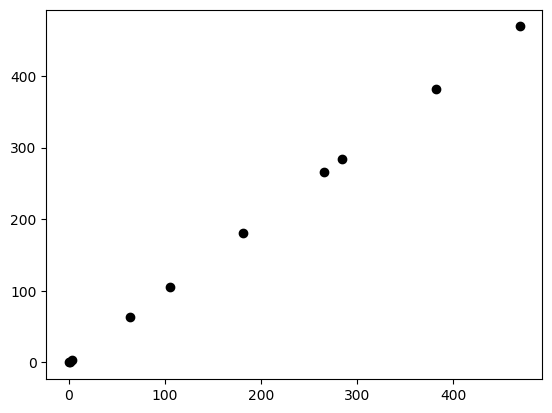

In [14]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)


t = Tuning()
t.load_event(nidq_file[2])
t.load_ptb(ptb_file[2])

In [21]:
spike_bin = spike.align(time_spike[2, 27], event, window=[0, 0.035])

In [26]:
hit = np.vectorize(len)(spike_bin) > 0

array([False,  True, False, False,  True, False, False, False,  True,
        True, False, False,  True,  True,  True,  True,  True,  True,
       False,  True,  True, False, False,  True,  True,  True,  True,
        True,  True,  True,  True, False, False, False,  True,  True,
       False, False,  True,  True, False,  True, False, False, False,
       False, False, False, False, False,  True, False,  True, False,
       False, False,  True,  True,  True, False,  True, False, False,
       False,  True,  True, False, False, False,  True,  True,  True,
       False,  True,  True,  True, False, False, False, False, False,
       False, False, False, False,  True, False,  True,  True, False,
       False, False,  True,  True, False, False,  True, False, False,
       False, False, False, False,  True, False,  True, False,  True,
        True,  True, False, False, False, False, False, False, False,
       False, False,  True, False,  True,  True,  True, False,  True,
       False, False,

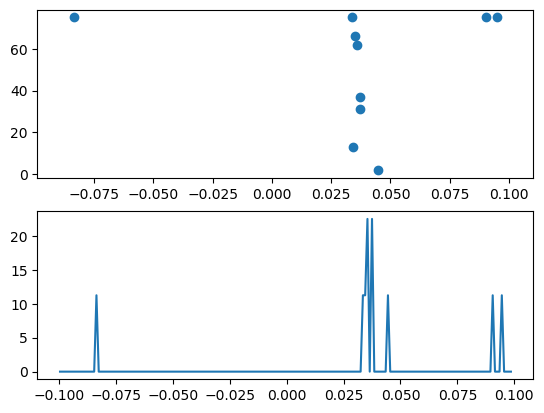

In [37]:
# plot hit trial
raster, psth = spike.plot(time_spike[2, 43], event[hit], np.ones_like(event[hit]), 
                          window=[-0.1, 0.1], binsize=0.001, resolution=5)

plt.subplot(2, 1, 1)
plt.scatter(raster['x'][0], raster['y'][0])
plt.subplot(2, 1, 2)
plt.plot(psth['t'], psth['bar'][0, :])

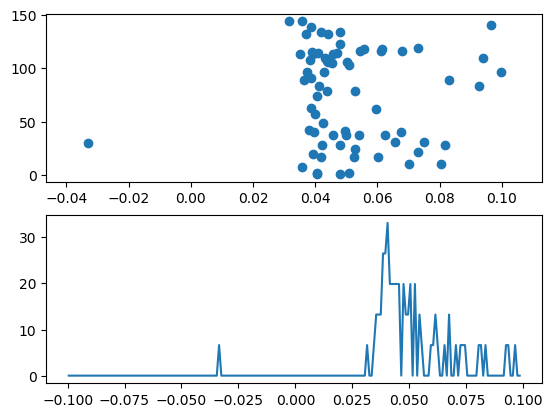

In [38]:
# plot hit trial
raster, psth = spike.plot(time_spike[2, 43], event[~hit], np.ones_like(event[~hit]), 
                          window=[-0.1, 0.1], binsize=0.001, resolution=5)

plt.subplot(2, 1, 1)
plt.scatter(raster['x'][0], raster['y'][0])
plt.subplot(2, 1, 2)
plt.plot(psth['t'], psth['bar'][0, :])

In [33]:
# explain cumulative plot
base = np.random.choice(2, size=(10000, 3*1000), p=[0.95, 0.05])
event = np.random.choice(2, size=(100, 3*1000), p=[0.95, 0.05])
event[:, 1000:2000] = np.random.choice(2, size=(100, 1000), p=[0.9, 0.1])

x = np.where(x)
x2 = np.w

In [35]:
np.where(y)

(array([ 0,  0,  0, ..., 99, 99, 99]),
 array([  63,  109,  112, ..., 2905, 2945, 2976]))